In [1]:
import mne
import os
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

%matplotlib inline

### Load data

In [2]:
subject_number = 'subject9'
patient_id = 'm191'
target = 'dlpfc'
day = 'day1'
head_circumference = '58'

In [38]:
data_path = f'/Users/Bella/Desktop/Grosenick_Lab/eeg_patient_data/mdd_dlpfc/{subject_number}_{patient_id}_{target}_{head_circumference}/mne'
raw_path = data_path + f'm191_{day}_autoreject_raw.fif'
epochs_path = data_path + f'm191_{day}_autoreject_epo.fif'
ICA_path = data_path + '/ICA'

In [39]:
raw = mne.io.read_raw_fif(raw_path, preload='True')
raw = raw.set_eeg_reference(ref_channels="average", projection=False)
raw.info['bads'] = ['VREF']

Opening raw data file /Users/Bella/Desktop/Grosenick_Lab/eeg_patient_data/mdd_dlpfc/subject9_m191_dlpfc_58/mne/m191_day1_autoreject_raw.fif...
    Read a total of 1 projection items:
        Average EEG reference (1 x 257)  idle
    Range : 0 ... 109544 =      0.000 ...   109.544 secs
Ready.
Reading 0 ... 109544  =      0.000 ...   109.544 secs...
EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Removing existing average EEG reference projection.


In [40]:
raw.info

Measurement date,"April 13, 2023 11:31:22 GMT"
Experimenter,Unknown
Participant,Unknown
Digitized points,260 points
Good channels,"256 EEG, 2 Stimulus"
Bad channels,VREF
EOG channels,Not available
ECG channels,Not available
Sampling frequency,1000.00 Hz
Highpass,0.10 Hz
Lowpass,500.00 Hz


In [41]:
raw_filt = raw.copy().filter(l_freq=1, h_freq=100)

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 1e+02 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 1.00
- Lower transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 0.50 Hz)
- Upper passband edge: 100.00 Hz
- Upper transition bandwidth: 25.00 Hz (-6 dB cutoff frequency: 112.50 Hz)
- Filter length: 3301 samples (3.301 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    0.2s


In [60]:
raw_filt.plot()

Using pyopengl with version 3.1.6


Channels marked as bad:
['VREF']


Effective window size : 2.048 (s)
Plotting power spectral density (dB=True).
Effective window size : 2.048 (s)


/var/folders/bf/tx13kltn043fzjw05wb4ck0w0000gn/T/ipykernel_8498/1018784685.py:1: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  raw.compute_psd().plot()
/Users/Bella/mambaforge/envs/IClabel/lib/python3.12/site-packages/mne/viz/utils.py:167: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


Plotting power spectral density (dB=True).


/var/folders/bf/tx13kltn043fzjw05wb4ck0w0000gn/T/ipykernel_8498/1018784685.py:2: FutureWarning: The value of `amplitude='auto'` will be removed in MNE 1.8.0, and the new default will be `amplitude=False`.
  raw_filt.compute_psd().plot();
/Users/Bella/mambaforge/envs/IClabel/lib/python3.12/site-packages/mne/viz/utils.py:167: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


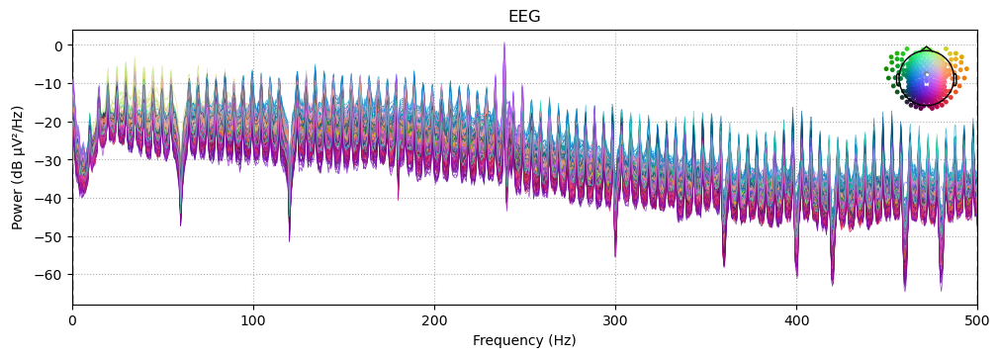

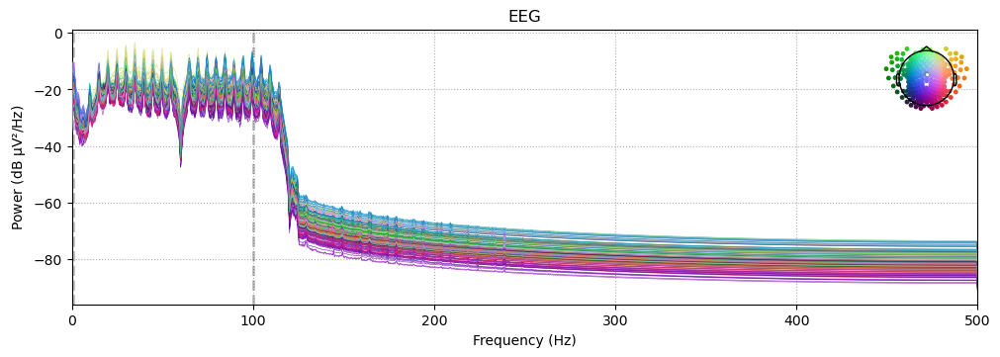

In [43]:
raw.compute_psd().plot()
raw_filt.compute_psd().plot();

In [44]:
raw_filt.set_eeg_reference(ref_channels="average", projection=False)

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


Measurement date,"April 13, 2023 11:31:22 GMT"
Experimenter,Unknown
Participant,Unknown
Digitized points,260 points
Good channels,"256 EEG, 2 Stimulus"
Bad channels,VREF
EOG channels,Not available
ECG channels,Not available
Sampling frequency,1000.00 Hz
Highpass,1.00 Hz
Lowpass,100.00 Hz


In [45]:
events = mne.find_events(raw, stim_channel = 'DIN1')
epochs = mne.Epochs(raw, events, tmin=-0.08, tmax=0.12, baseline= (0,0), preload=True)

# Important to use no baseline correction on data that will go through ICA
events_ica = mne.find_events(raw_filt, stim_channel = 'DIN1')
epochs_ica= mne.Epochs(raw_filt, events_ica, tmin=-0.08, tmax=0.12, baseline=None, preload=True)

545 events found on stim channel DIN1
Event IDs: [1]
Not setting metadata
545 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 545 events and 201 original time points ...
0 bad epochs dropped
545 events found on stim channel DIN1
Event IDs: [1]
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 545 events and 201 original time points ...
0 bad epochs dropped


Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated


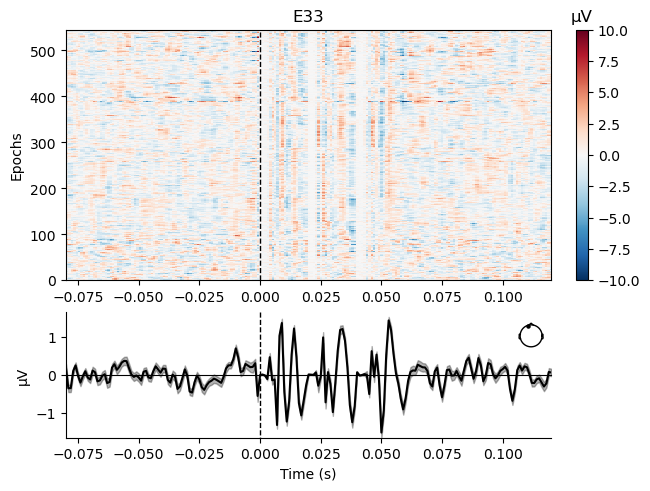

Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated


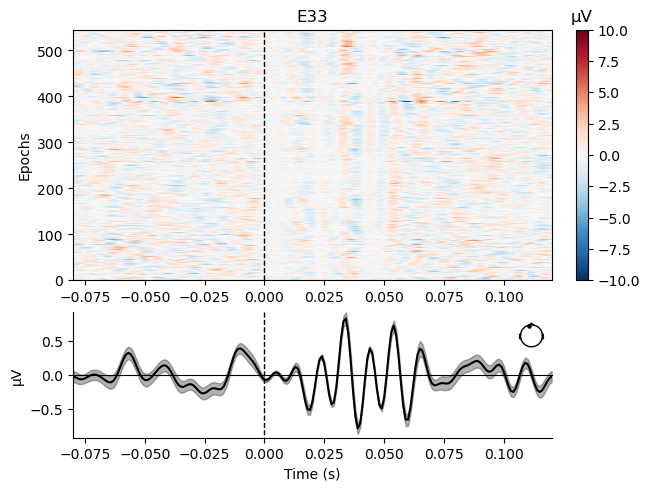

In [49]:
fig = epochs.plot_image(picks=['E33'], vmin=-10, vmax=10)
fig[0].axes[1].set_ylim([-10,10])
fig[0]
fig[0].savefig(f'{ERP_ICA_path}/{patient_id}_{day}_E33_autoreject.png')

fig = epochs_ica.plot_image(picks=['E33'], vmin=-10, vmax=10)
fig[0].axes[1].set_ylim([-10,10])
fig[0]
fig[0].savefig(f'{ERP_ICA_path}/{patient_id}_{day}_E33_1Hz-100Hz_autoreject.png') ;

### Run ICA on cleaned epochs

In [50]:
from mne.preprocessing import ICA, corrmap
ica_method = 'infomax'
ica = ICA(n_components=250, max_iter=1000, random_state=42, method=ica_method, fit_params=dict(extended=True))
ica.fit(raw_filt)

# Fitting ICA took 342.7s sec with Picard, 100.5 s with FastICA
# Components look better with Picard than FastICA, but Picard was not converging with auto 500 iters. Try Picard with 1000 iterations
# Fraction of eeg variance explained by all components: 0.9999970354209685

Fitting ICA to data using 256 channels (please be patient, this may take a while)
Selecting by number: 250 components
Computing Extended Infomax ICA
Fitting ICA took 267.7s.


Method,infomax
Fit parameters,extended=Truemax_iter=1000
Fit,1000 iterations on raw data (109545 samples)
ICA components,250
Available PCA components,256
Channel types,eeg
ICA components marked for exclusion,—


In [51]:
# Variance explained by all components
explained_var_ratio = ica.get_explained_variance_ratio(raw_filt)
for channel_type, ratio in explained_var_ratio.items():
    print(f"Fraction of {channel_type} variance explained by all components: {ratio}")
    
# Variance explained by first component
explained_var_ratio = ica.get_explained_variance_ratio(raw_filt, components=[0], ch_type="eeg")
ratio = (explained_var_ratio["eeg"])
print(f"Fraction of variance in EEG signal explained by first component: {ratio}")

Fraction of eeg variance explained by all components: 0.9999983719862113
Fraction of variance in EEG signal explained by first component: 0.04064066931676169


In [58]:
ica.plot_sources(raw_filt)

Creating RawArray with float64 data, n_channels=250, n_times=109545
    Range : 0 ... 109544 =      0.000 ...   109.544 secs
Ready.
Using pyopengl with version 3.1.6


    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 pro

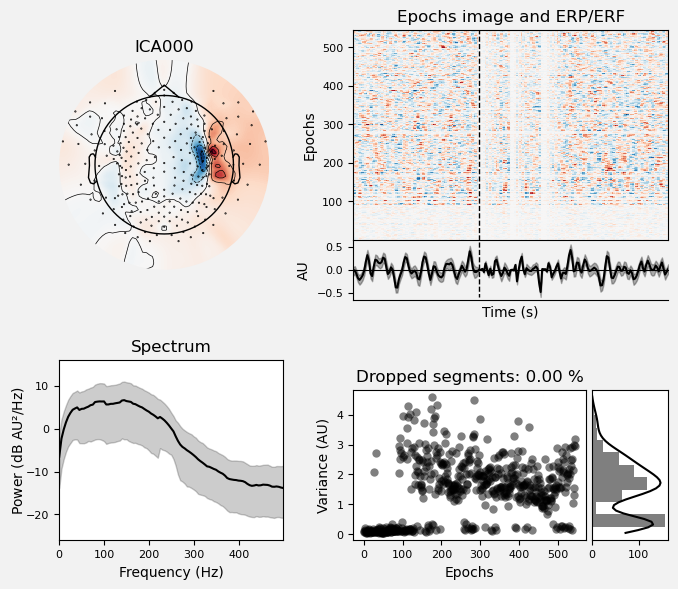

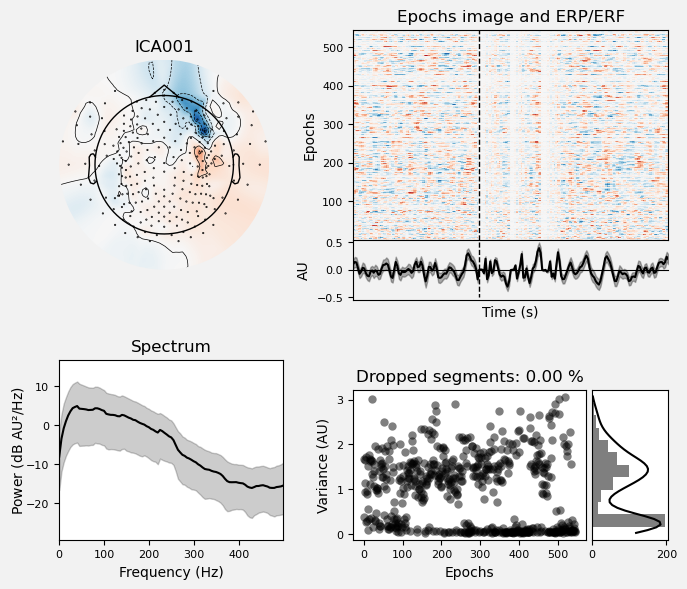

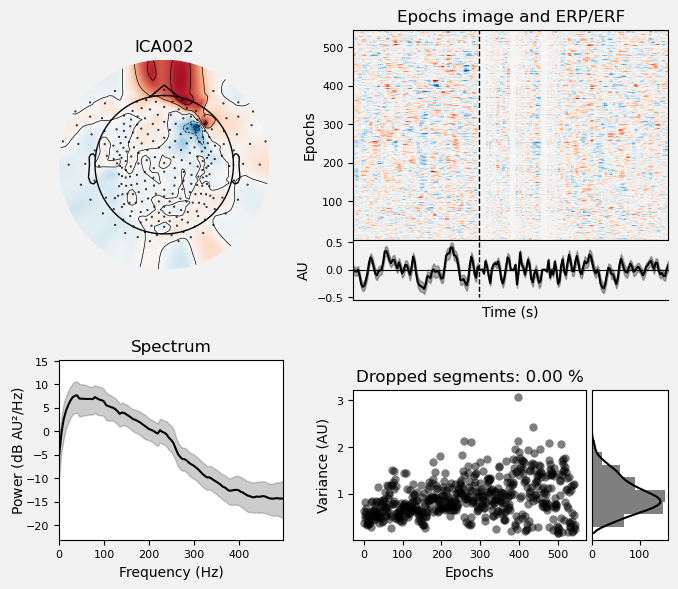

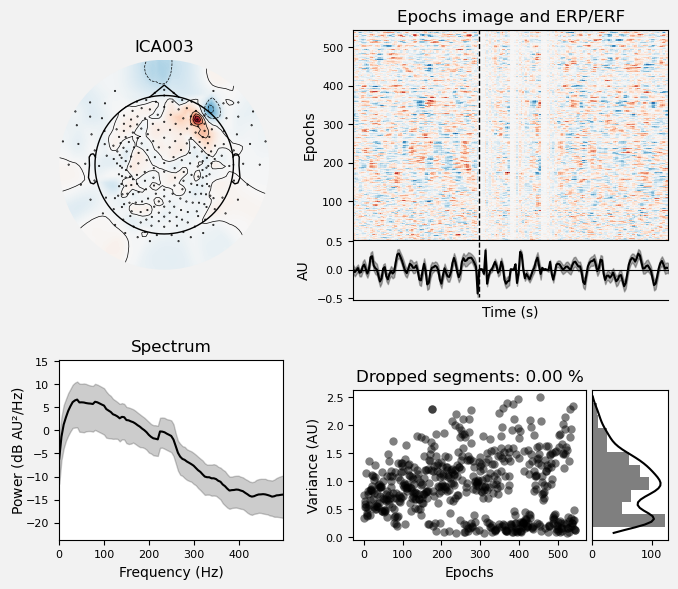

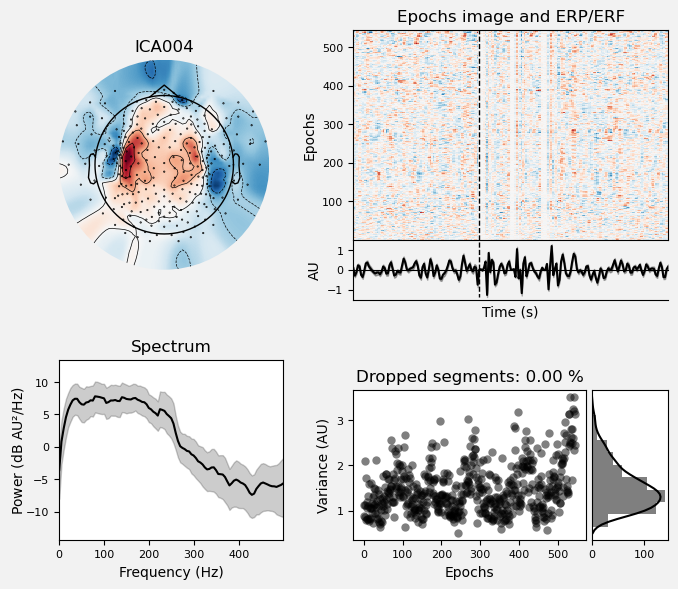

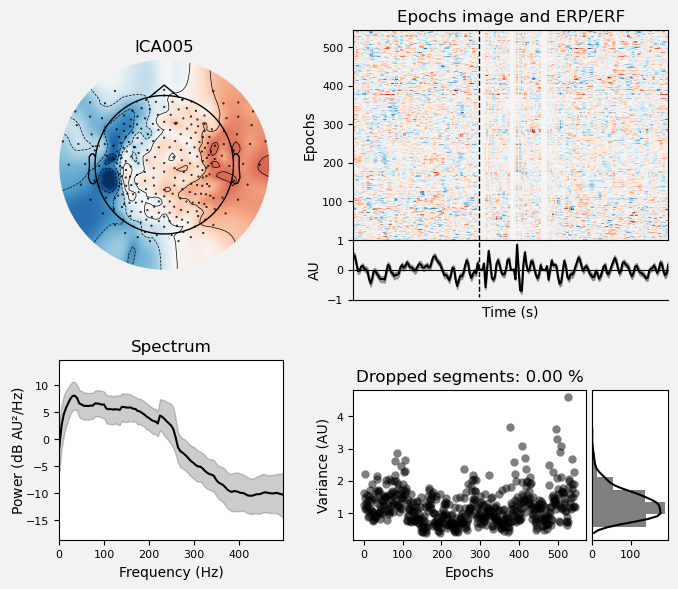

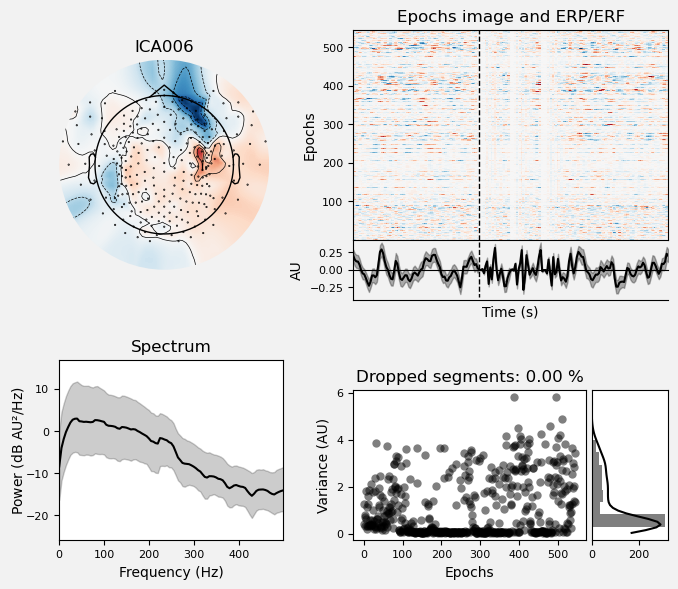

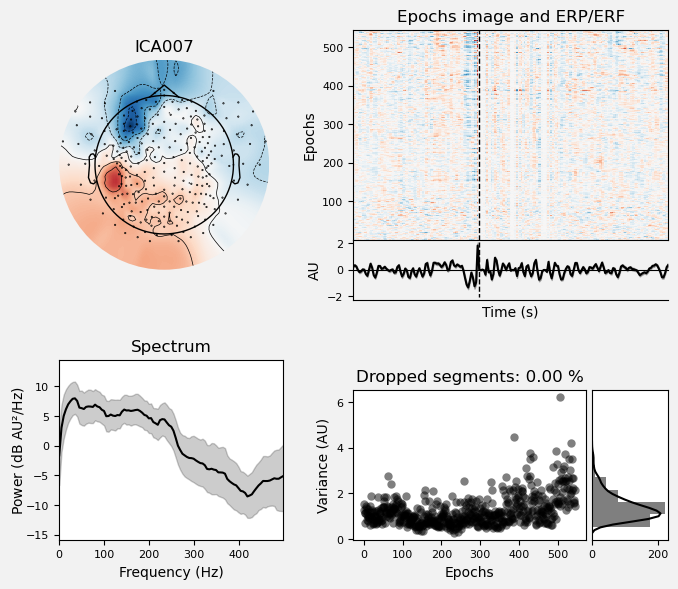

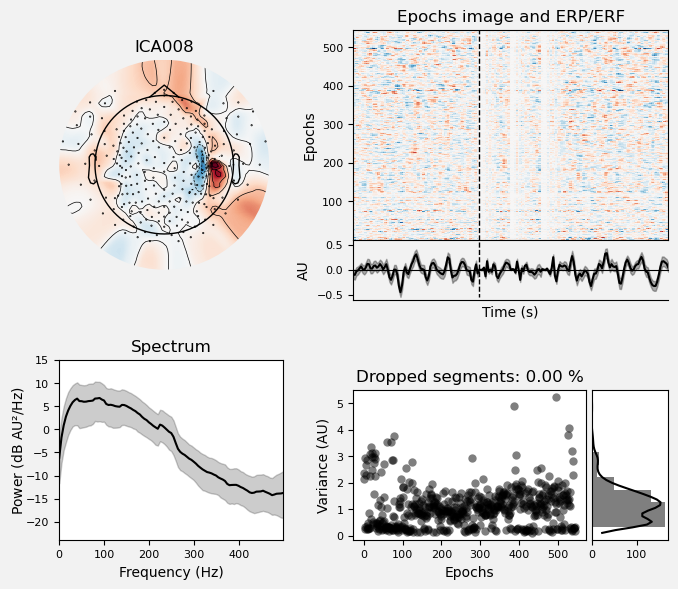

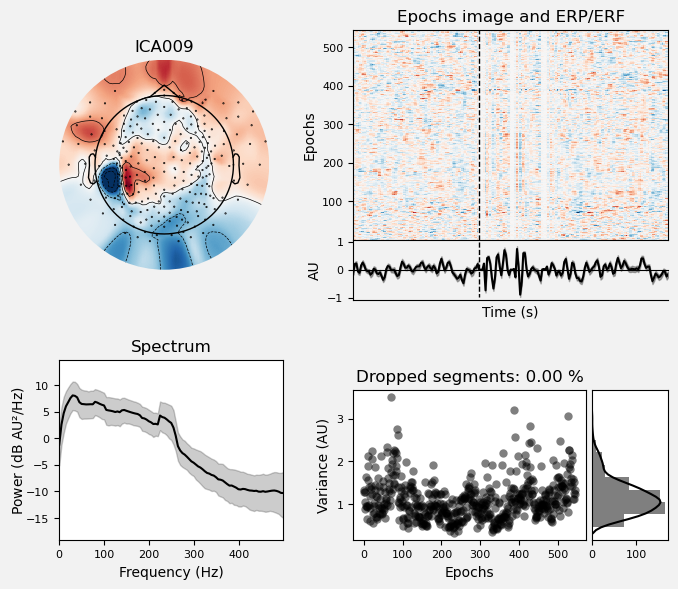

[<Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>]

In [52]:
ica.plot_properties(epochs, picks=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

Applying ICA to Raw instance
    Transforming to ICA space (250 components)
    Zeroing out 1 ICA component
    Projecting back using 256 PCA components


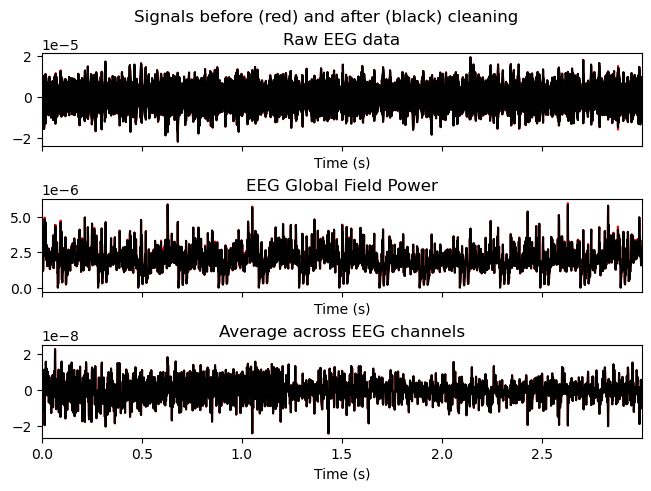

Applying ICA to Raw instance
    Transforming to ICA space (250 components)
    Zeroing out 1 ICA component
    Projecting back using 256 PCA components


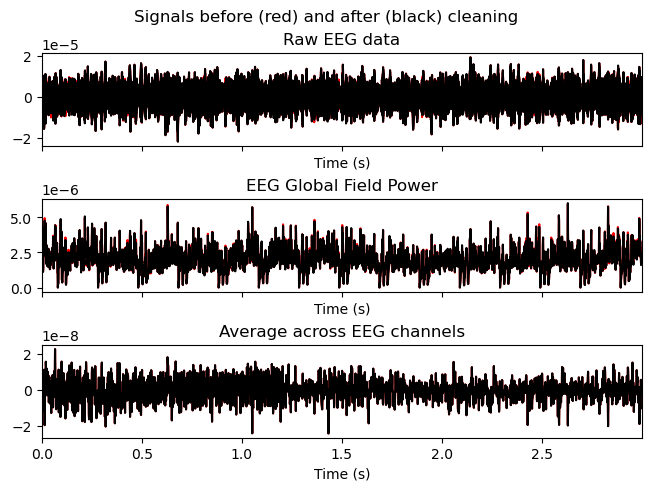

In [53]:
# Exclude first two components
ica.plot_overlay(raw, exclude=[0])
ica.plot_overlay(raw, exclude=[1]) ;

Plot ICA spatial sources

In [55]:
# Filter data to icalabel requirements
ica.save(f'{data_path}/{patient_id}_{day}_clean_extended_infomax_ica.fif')

Writing ICA solution to /Users/Bella/Desktop/Grosenick_Lab/eeg_patient_data/mdd_dlpfc/subject9_m191_dlpfc_58/mne/m191_day1_clean_extended_infomax_ica.fif...


Method,infomax
Fit parameters,extended=Truemax_iter=1000
Fit,1000 iterations on raw data (109545 samples)
ICA components,250
Available PCA components,256
Channel types,eeg
ICA components marked for exclusion,—


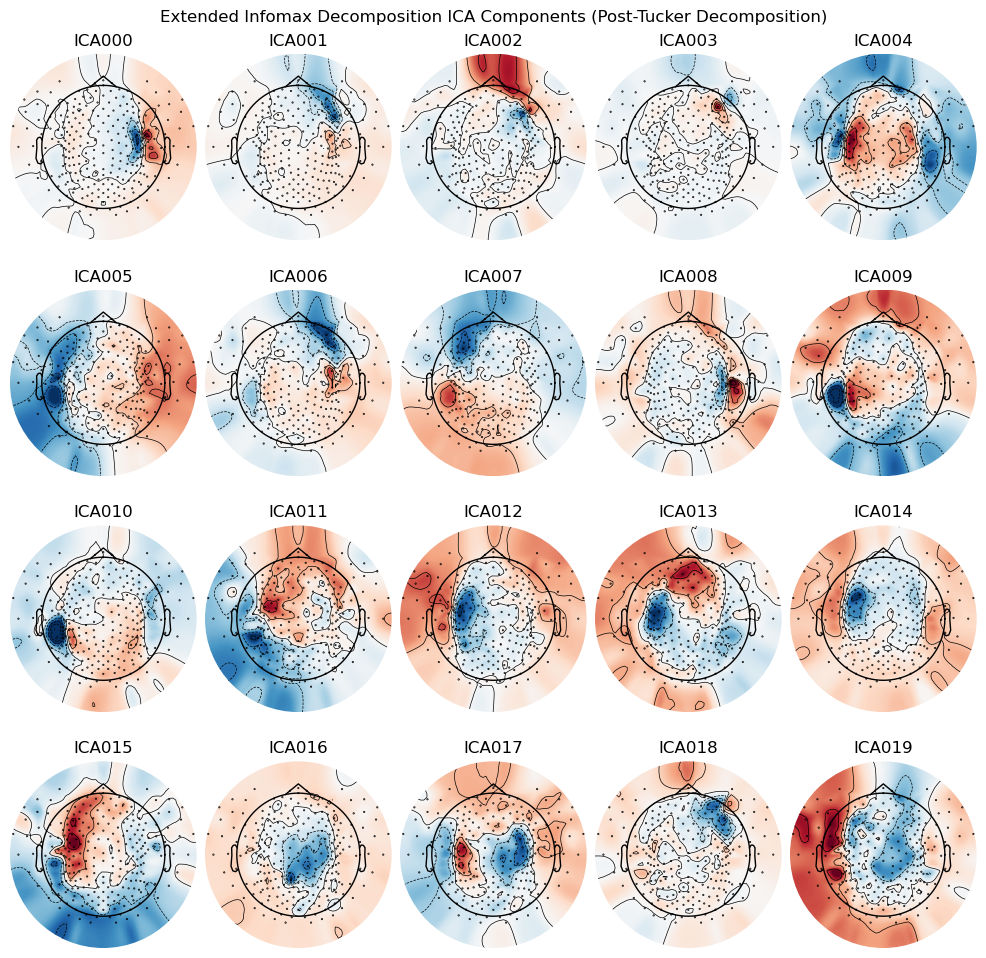

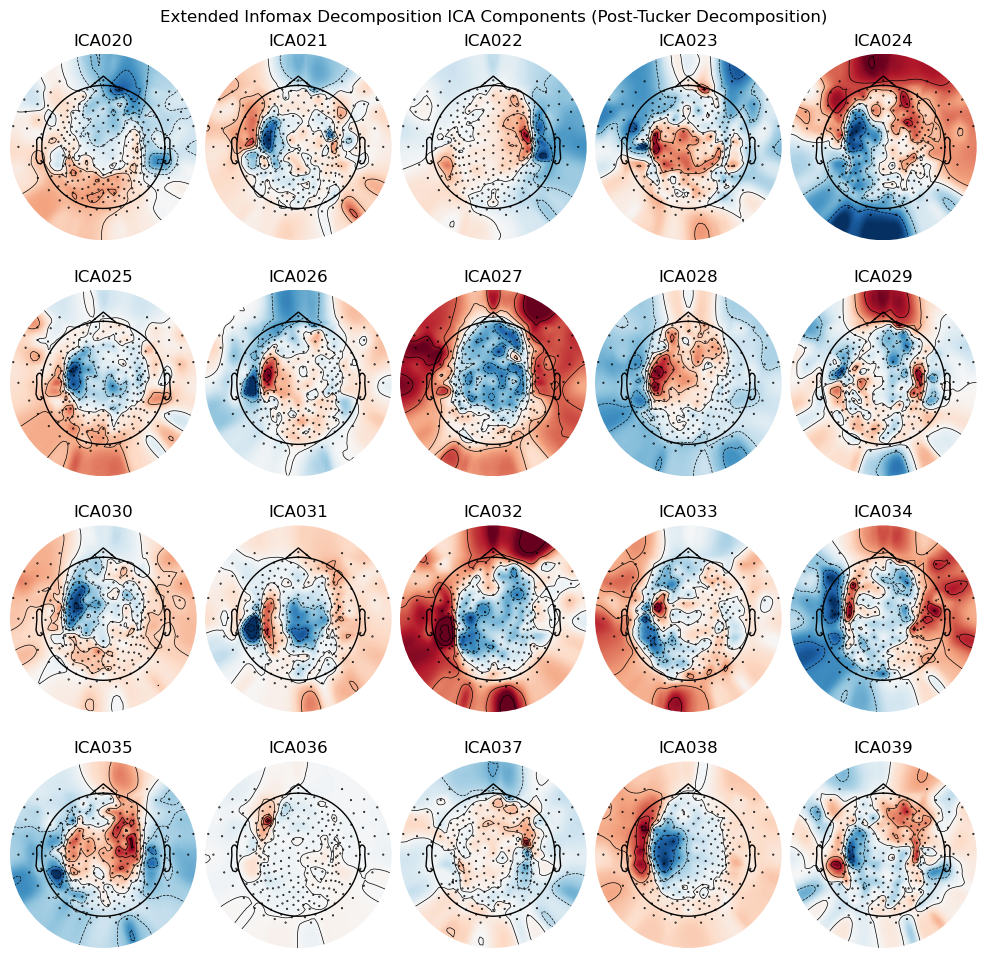

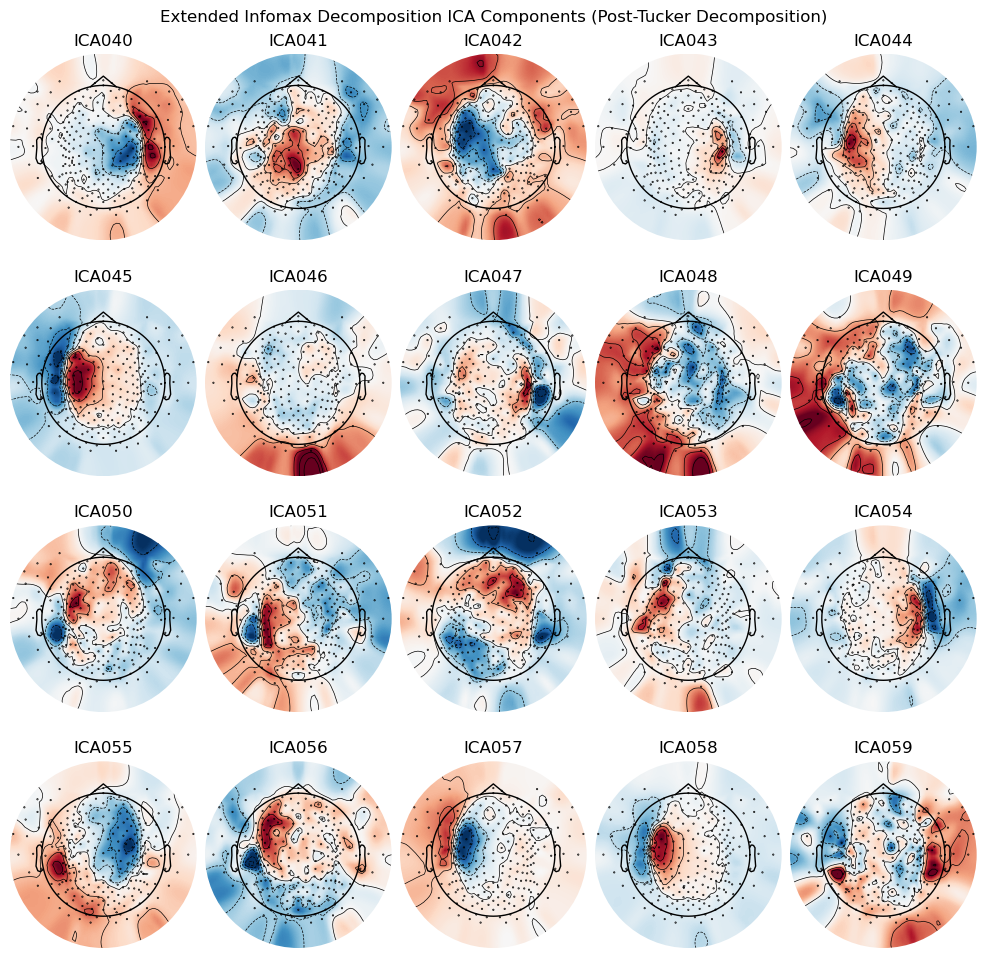

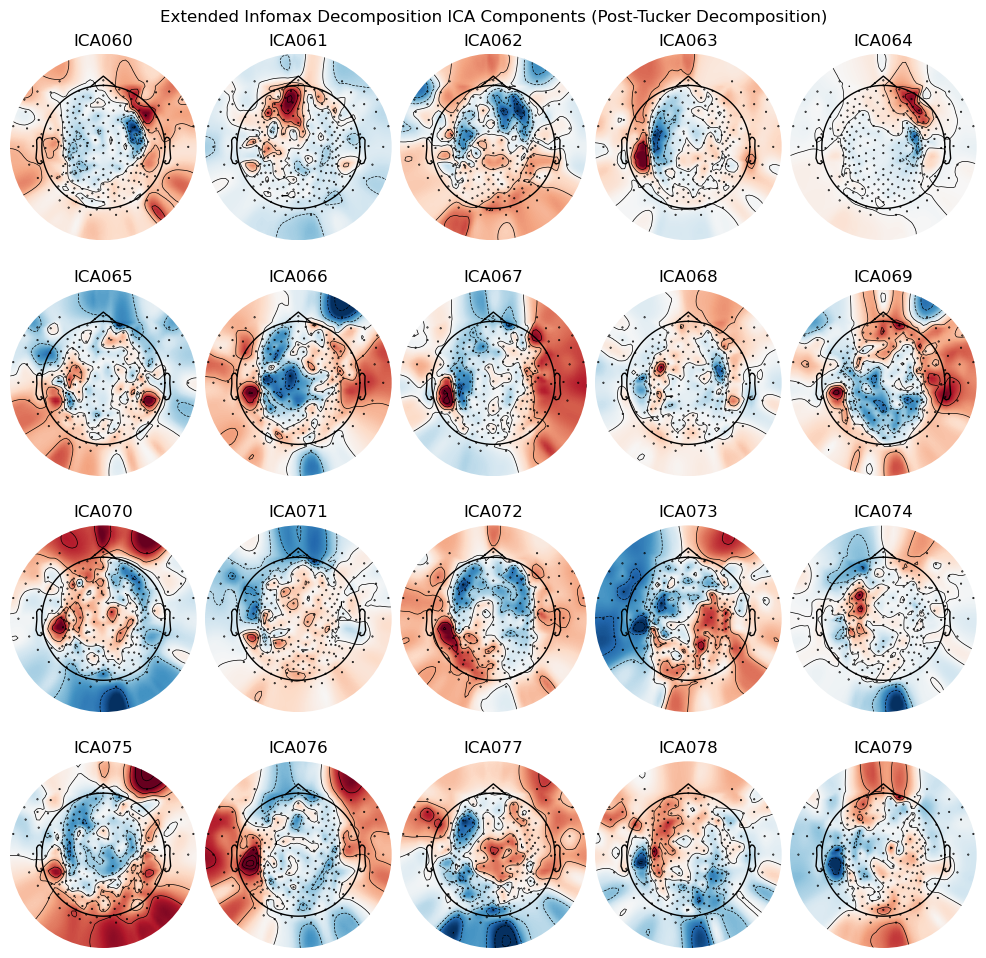

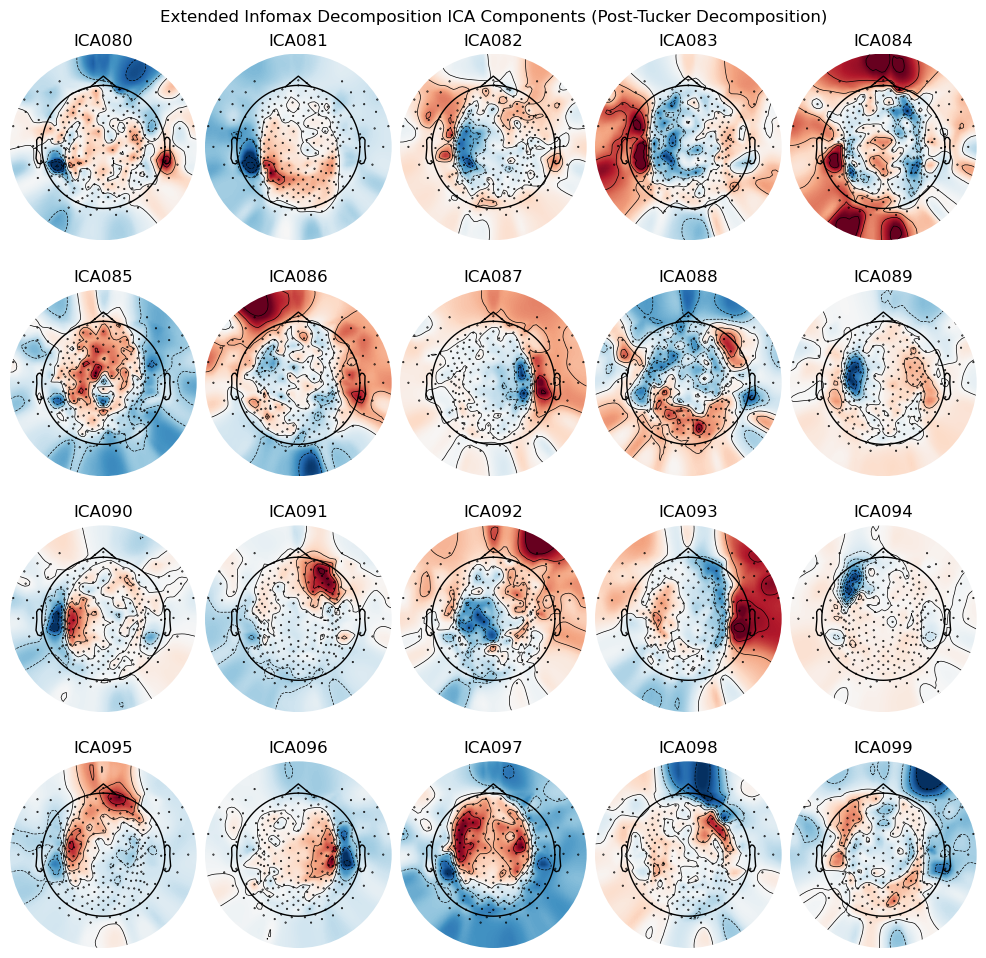

...

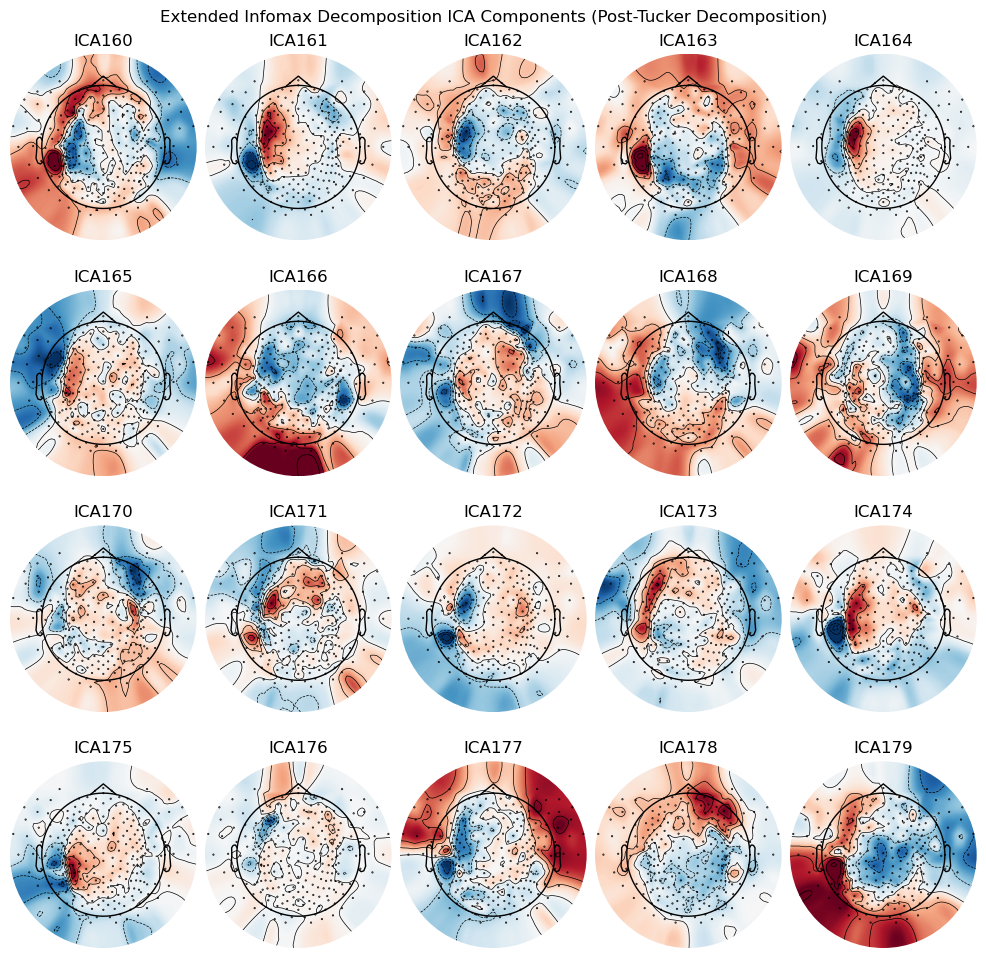

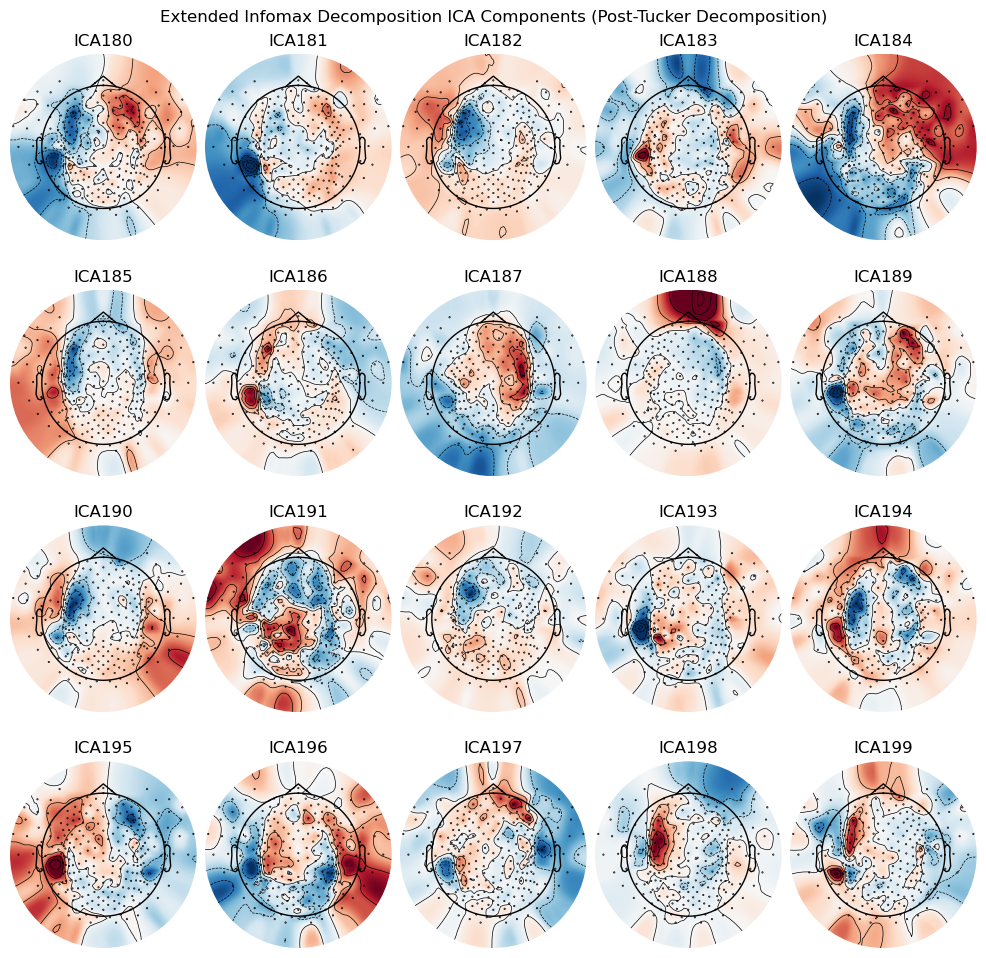

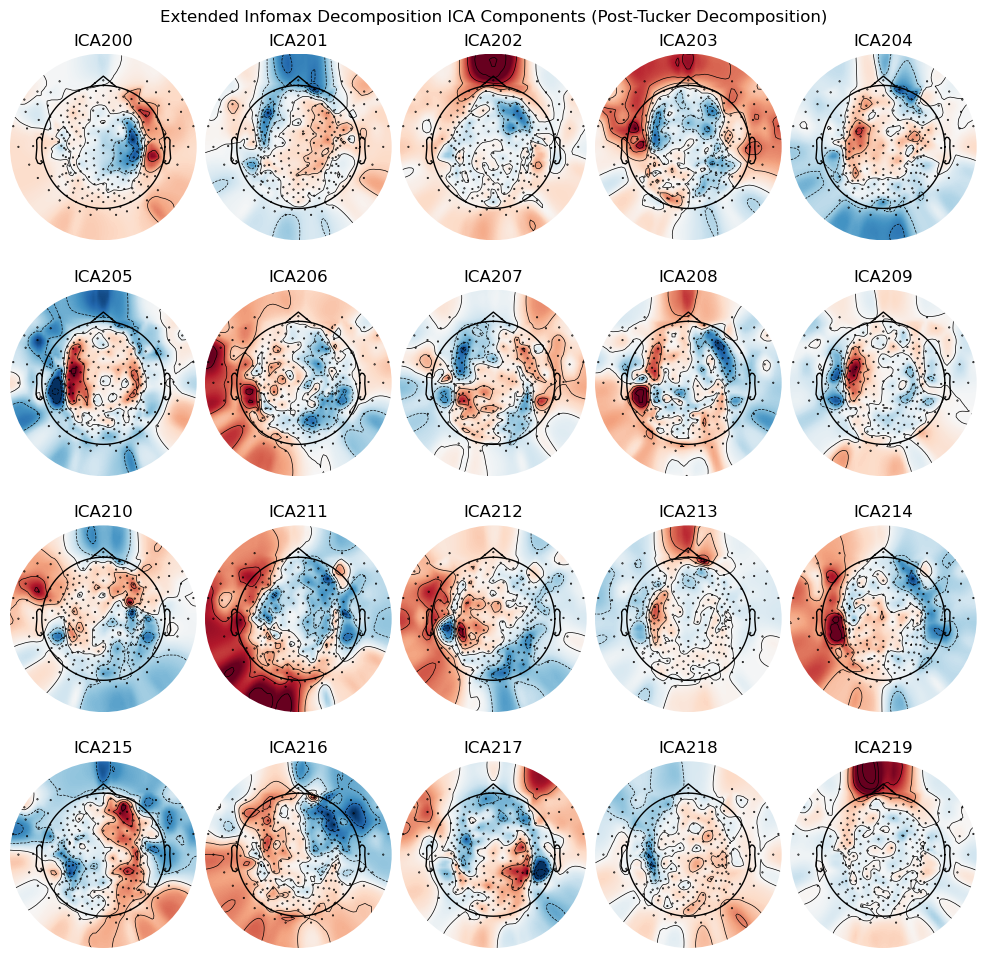

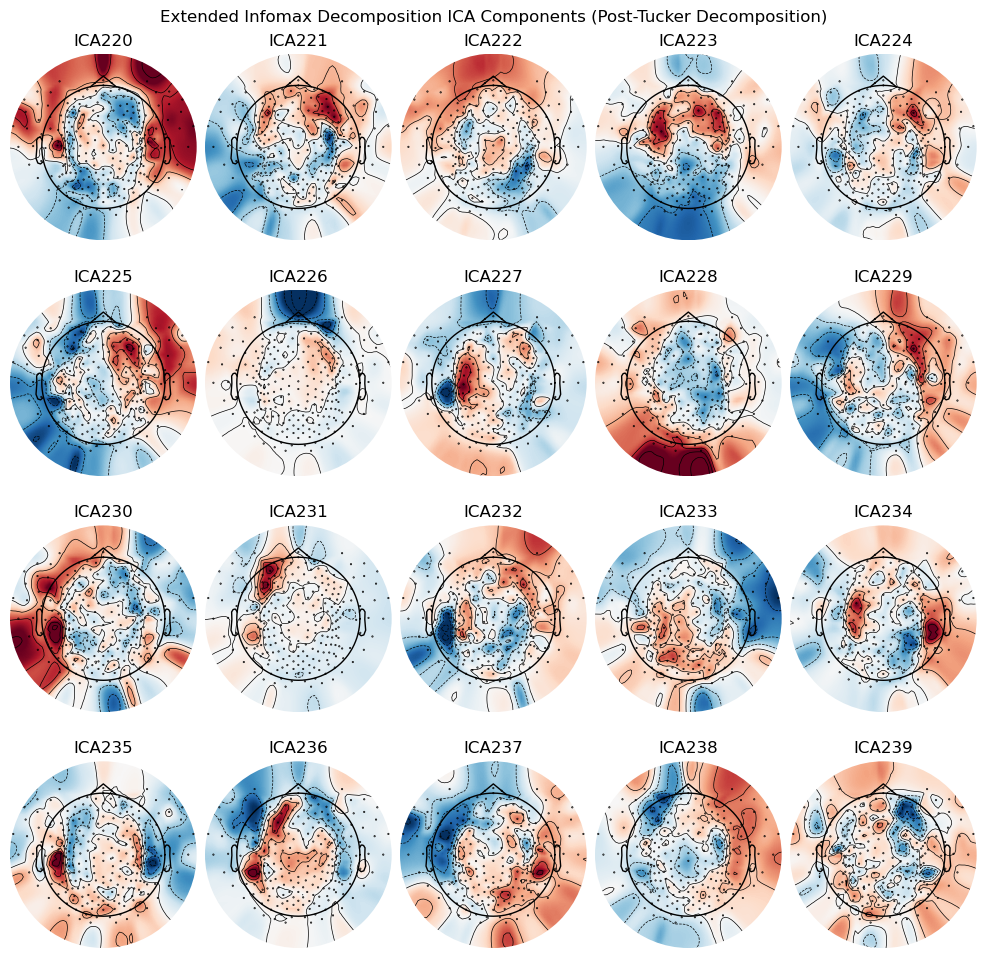

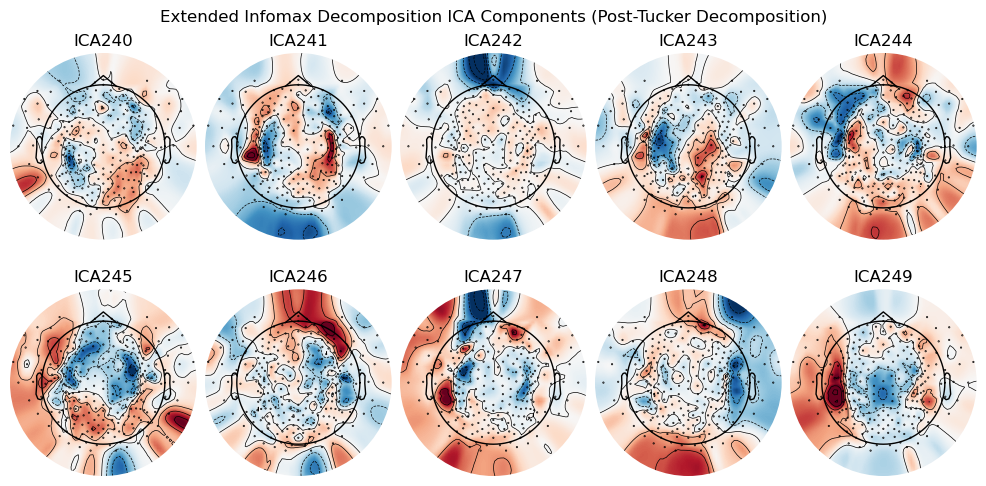

In [80]:
ica_method = 'infomax'
figs = ica.plot_components(title='Extended Infomax Decomposition ICA Components (Post-Tucker Decomposition)')
for i, fig in enumerate(figs):
    fig.savefig(f'{ERP_ICA_path}/topomaps/{day}/{ica_method}/{patient_id}_{day}_components_clean_extended_infomax_ica_component_{i}.png')

Plot ICA source traces

Plot cleaned data traces

In [56]:
from mne_icalabel import label_components
import time
tic = time.time()

# Use label_components function from ICLabel library to classify ICs and get their estimated probabilities
# Use raw_filt (high pass=1 Hz, low pass = 100 Hz) to comply with IClabel requirements
# IClabel tested only with FastICA, but its performance and accuracy should not be affected by the algorithm
print('  Using ICALabel to classify independent components.')
ic_labels = label_components(raw_filt, ica, method="iclabel")
labels = ic_labels["labels"]
print(labels)

print(time.time()-tic)
# icalabel kept ___ components

  Using ICALabel to classify independent components.
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
['muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle artifact', 'muscle art

In [57]:
# Exclude ICs not in 'keep' list and reconstruct cleaned raw data
keep=['brain']
exclude_idx = [idx for idx, label in enumerate(labels) if label not in keep]
include_idx = [idx for idx, label in enumerate(labels) if label in keep]
print(f"  Excluding these ICA components: {exclude_idx}")
print(f"  Including these ICA components: {include_idx}")
print(f'Number of components included: {len(include_idx)}')

  Excluding these ICA components: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 

In [110]:
eog_indices, eog_scores = ica.find_bads_eog(raw_filt, ch_name='E252', threshold=3, reject_by_annotation=True, measure='zscore')

Using EOG channel: E252
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.7s
[Parallel(n_jobs=1)]: Done  71 tasks      | elapsed:    1.4s
[Parallel(n_jobs=1)]: Done 161 tasks      | elapsed:    1.8s


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 s)



In [111]:
eog_indices.sort()
print(eog_indices)
print(f'Number of eog indices: {len(eog_indices)}')

[4, 14, 106, 107, 128, 167, 175]
Number of eog indices: 7


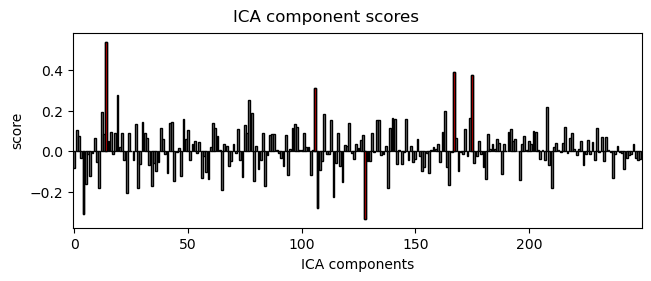

In [114]:
ica.plot_scores(eog_scores) ;

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
545 matching events found
No baseline correction applied
0 projection items activated


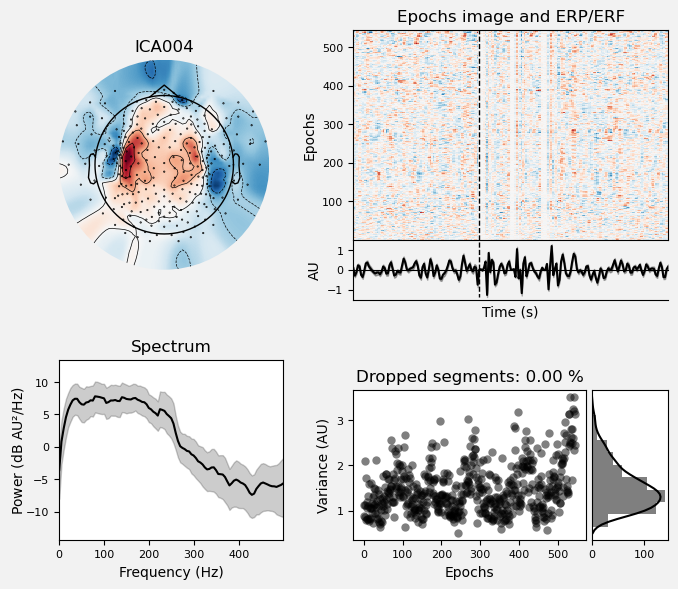

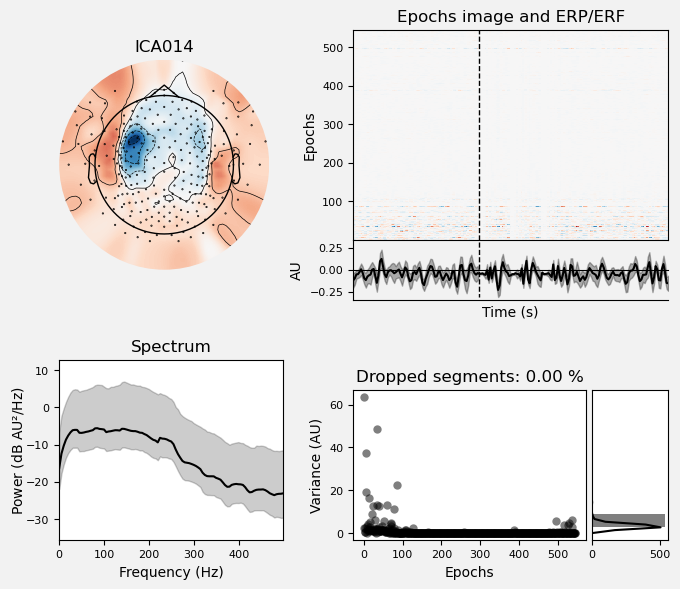

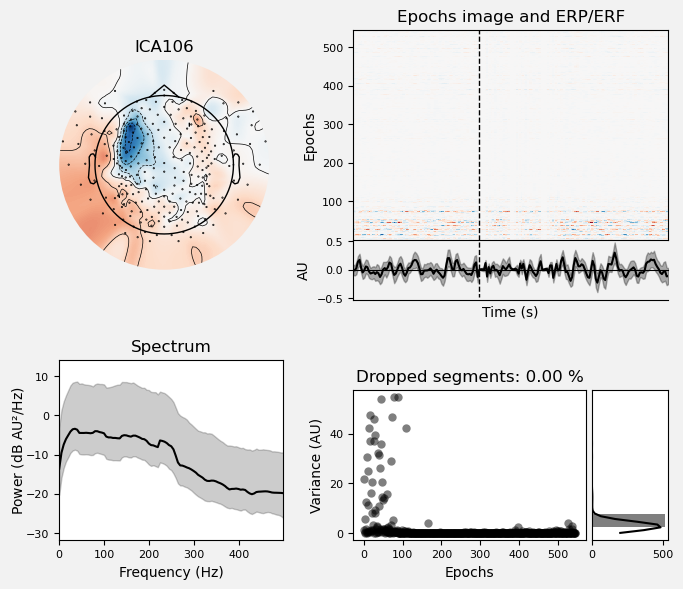

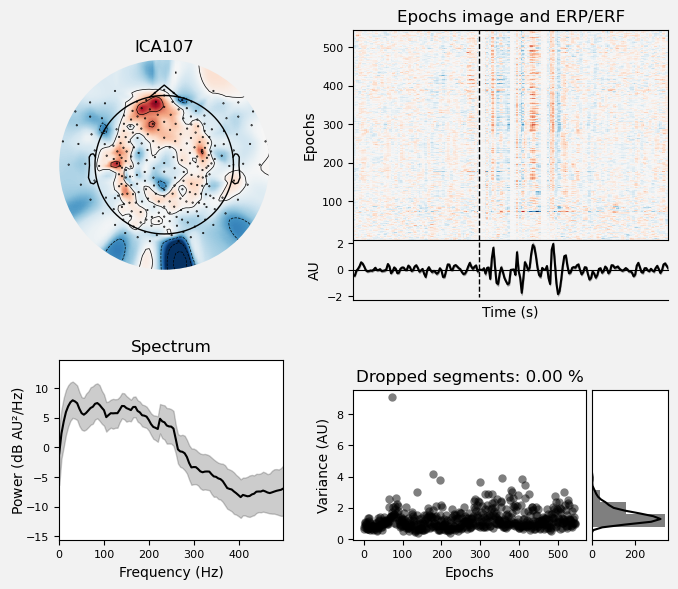

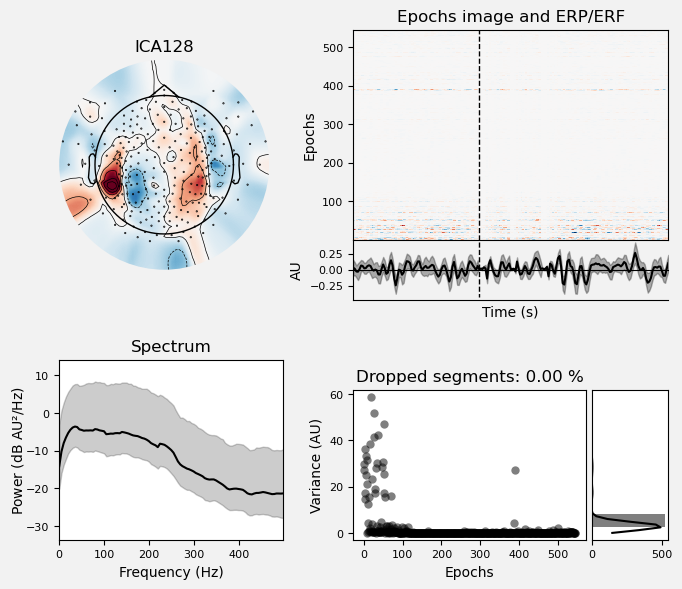

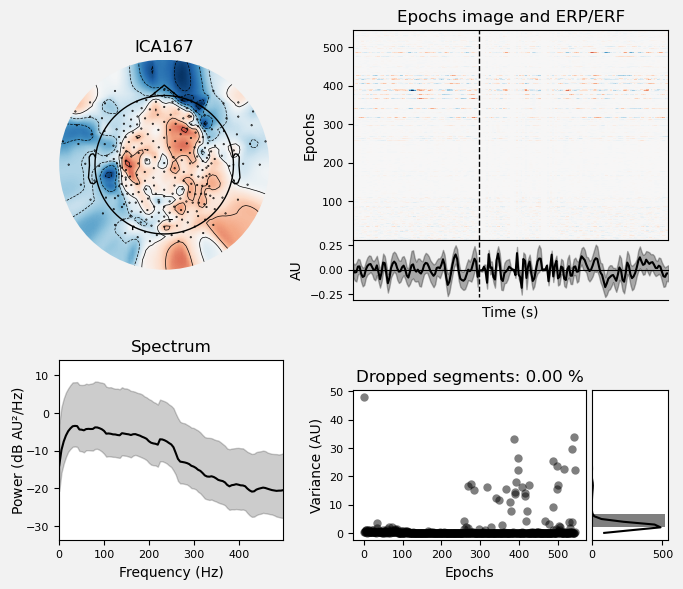

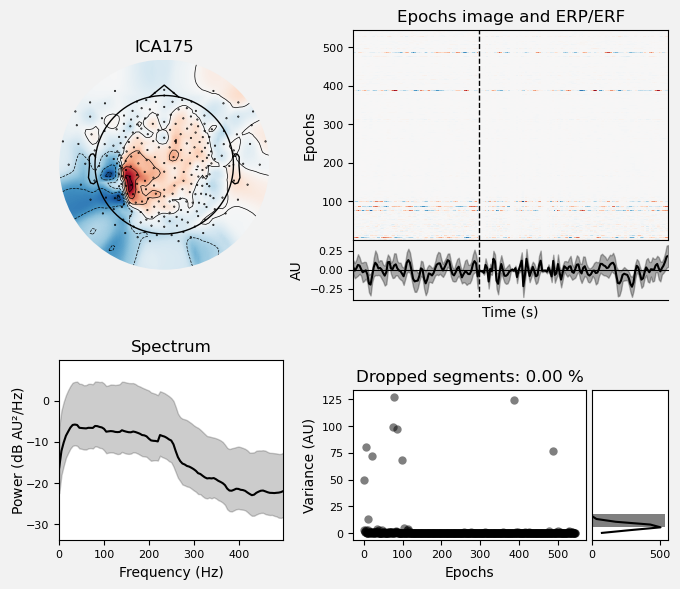

[<Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>]

In [116]:
# plot diagnostics
ica.plot_properties(epochs, picks=eog_indices)

In [117]:
# plot ICs applied to raw data, with ECG matches highlighted
ica.plot_sources(raw, show_scrollbars=False)

Creating RawArray with float64 data, n_channels=250, n_times=109545
    Range : 0 ... 109544 =      0.000 ...   109.544 secs
Ready.
Using pyopengl with version 3.1.6


In [118]:
# plot ICs applied to the averaged ECG epochs, with ECG matches highlighted
ica.plot_sources(eog_evoked)

NameError: name 'eog_evoked' is not defined

In [112]:
ica.exclude = eog_indices

In [29]:
# Create copy of raw (0.1 Hz hp filter) to apply ica solution to
raw_reconst = raw.copy()
ica.apply(raw_reconst, exclude=exclude_idx, verbose=True)

Applying ICA to Raw instance
    Transforming to ICA space (250 components)
    Zeroing out 185 ICA components
    Projecting back using 256 PCA components


Measurement date,"April 11, 2023 01:36:42 GMT"
Experimenter,Unknown
Participant,Unknown
Digitized points,260 points
Good channels,"256 EEG, 2 Stimulus"
Bad channels,VREF
EOG channels,Not available
ECG channels,Not available
Sampling frequency,1000.00 Hz
Highpass,0.00 Hz
Lowpass,500.00 Hz


In [33]:
raw_reconst = raw_reconst.set_eeg_reference("average", projection=False)

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Channels marked as bad:
['VREF']


In [34]:
raw_reconst.plot()

Using pyopengl with version 3.1.6


Channels marked as bad:
['VREF']


In [35]:
events_reconst = mne.find_events(raw_reconst, stim_channel = 'DIN1')
epochs_reconst = mne.Epochs(raw_reconst, events_reconst, tmin=-0.08, tmax=0.12, baseline= (0,0), preload=True)

600 events found on stim channel DIN1
Event IDs: [1]
Not setting metadata
600 matching events found
Applying baseline correction (mode: mean)
0 projection items activated
Using data from preloaded Raw for 600 events and 201 original time points ...
0 bad epochs dropped


    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated
Not setting metadata
600 matching events found
No baseline correction applied
0 pro

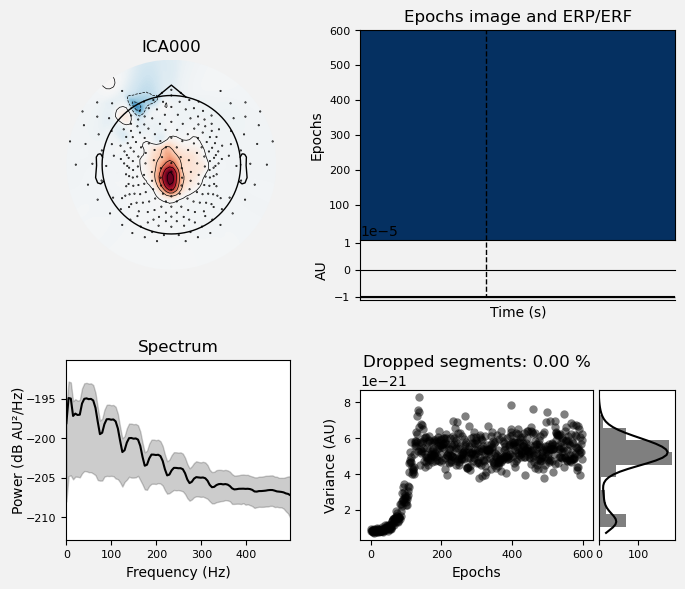

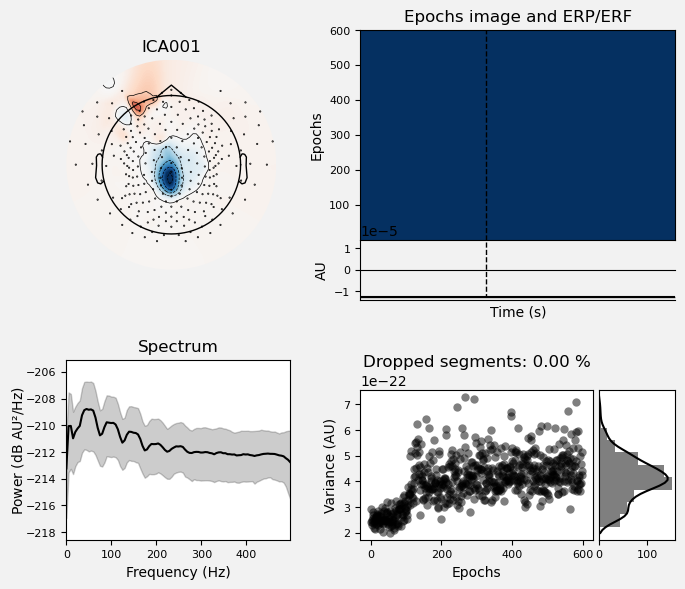

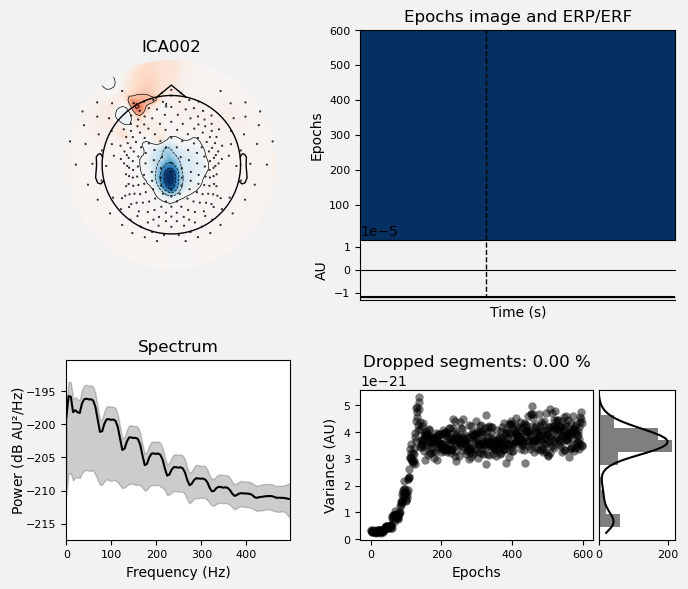

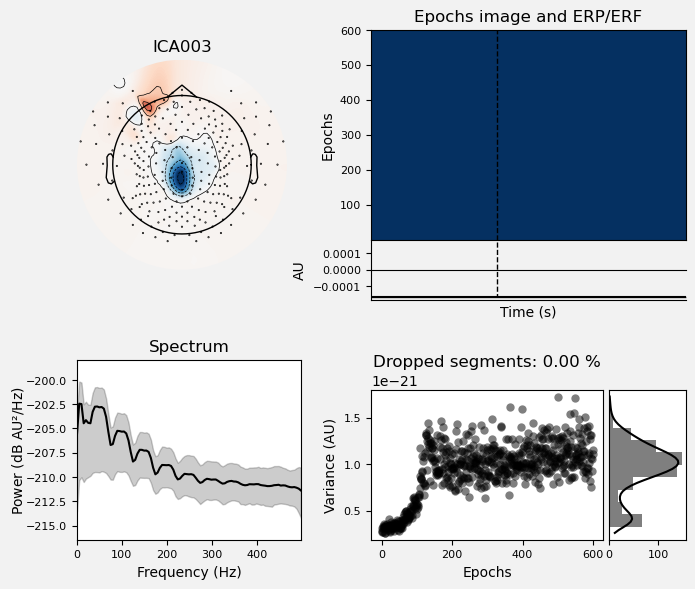

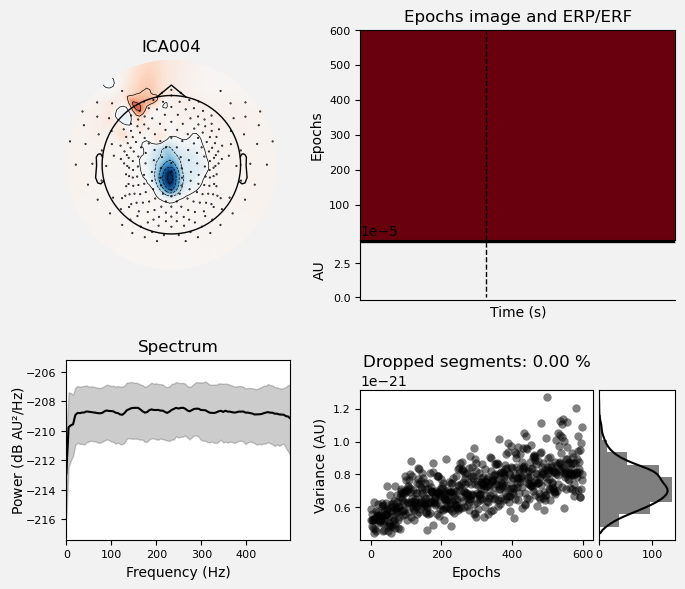

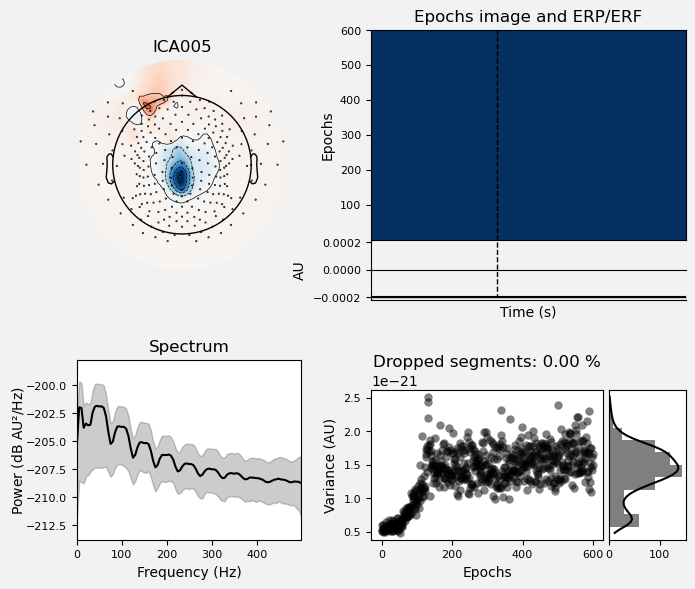

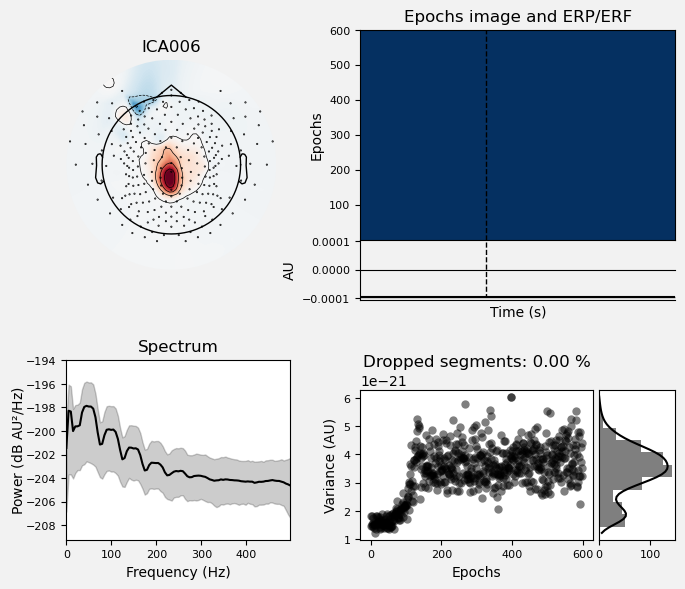

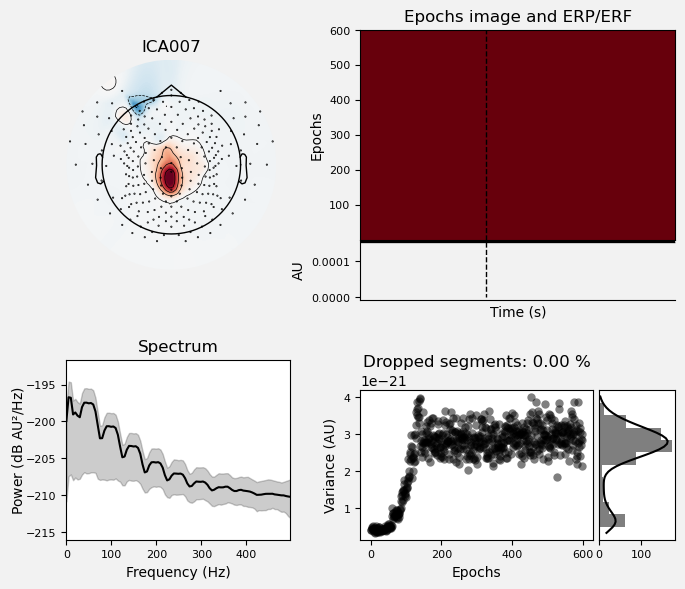

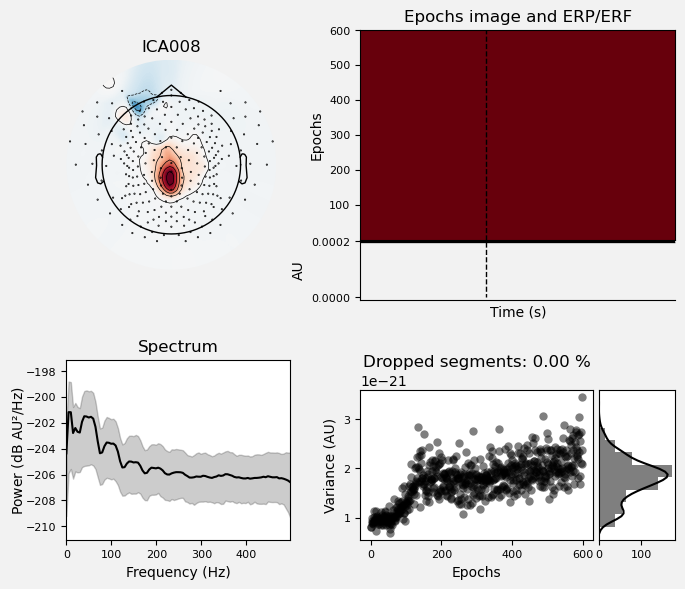

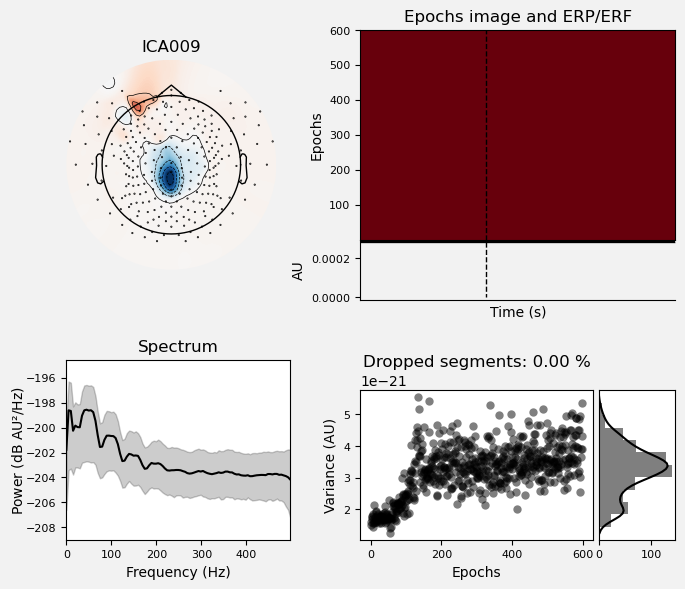

[<Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>,
 <Figure size 700x600 with 6 Axes>]

In [36]:
ica.plot_properties(epochs_reconst, picks=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated


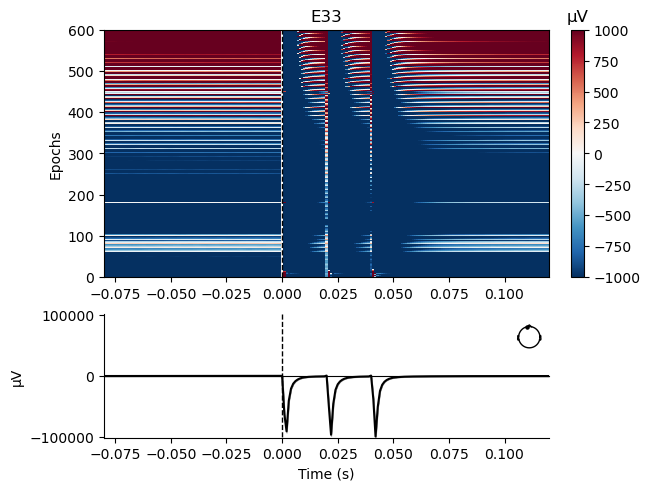

Not setting metadata
600 matching events found
No baseline correction applied
0 projection items activated


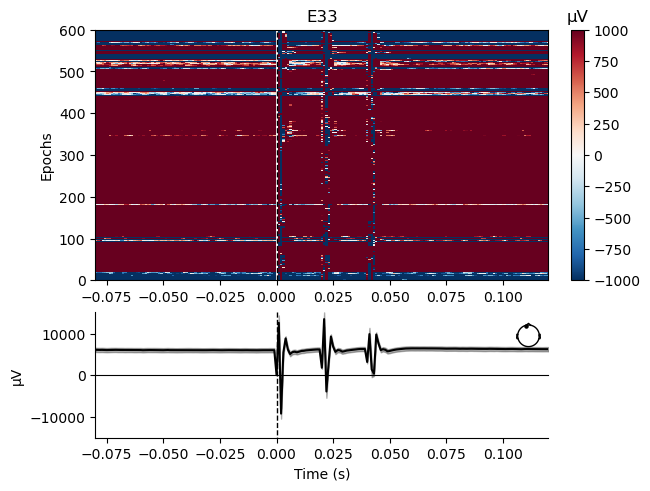

In [37]:
ERP_ICA_path = '/Users/Bella/Desktop/Grosenick_Lab/eeg_patient_data/mdd_dlpfc/subject9_m191_dlpfc_58/mne/ERP/ICA'
fig = epochs.plot_image(picks=['E33'], vmin=-1000, vmax=1000)
fig[0].axes[1].set_ylim([-100000,100000])
fig[0]

fig = epochs_reconst.plot_image(picks=['E33'], vmin=-1000, vmax=1000)
fig[0].axes[1].set_ylim([-10000,10000])
fig[0]
fig[0].savefig(f'{ERP_ICA_path}/{patient_id}_{day}_E33_raw_extended_infomax_ICA_IClabel.png') ;